<a href="https://colab.research.google.com/github/tprasetyo/Colorectal_Cancer_Segmentation/blob/main/EBHI_Seg_Final_Project_(AttUNet_PyTorch).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <font color = 'orange'> Colorectal Cancer Image Segmentation </font>
## <font color = 'yellow'> Teguh Prasetyo </font>
### Group : Ada Lovelace & Dicky Adi
#### 4 November 2023


# This was our Final Project from Indonesia AI Computer Vision Bootcamp 2

 We used **Enteroscope Biopsy Histopathological Hematoxylin and Eosin Image Dataset for Image Segmentation Tasks (EBHI-Seg)**

 The Dataset is available for public, and downloaded from https://figshare.com/articles/dataset/EBHISEG/21540159/1

 Shi L, Li X, Hu W, Chen H, Chen J, Fan Z, Gao M, Jing Y, Lu G, Ma D, Ma Z, Meng Q, Tang D, Sun H, Grzegorzek M, Qi S, Teng Y, Li C. EBHI-Seg: A novel enteroscope biopsy histopathological hematoxylin and eosin image dataset for image segmentation tasks. Front Med (Lausanne). 2023 Jan 24;10:1114673. doi: 10.3389/fmed.2023.1114673. PMID: 36760405; PMCID: PMC9902656.

# Environment Setup
## Library Installation

In [5]:
!pip install pytorch-lightning

In [6]:
!pip install torchinfo

## Load Library

In [7]:
import pandas as pd
import numpy as np
import os
import json
import cv2
import pytorch_lightning as pl
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.utils as utils
import torchvision.transforms.functional as tf
import torch.nn.functional as f
import torchvision
import torchmetrics as metrics
from pytorch_lightning.loggers import TensorBoardLogger
from pytorch_lightning.callbacks import LearningRateMonitor
from PIL import Image, ImageColor
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torchinfo import summary
from torch.utils.data import DataLoader, Dataset, random_split
from sklearn.model_selection import train_test_split
from pathlib import Path
#from models.unetArch import UNet, dice_loss, multiclass_dice_coef
from torchmetrics.functional.classification import multilabel_precision, multilabel_recall
import random

### Connect to Google Drive

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Unzip The Dataset and Load to Colaboratory

In [9]:
import zipfile

zip_path = '/content/drive/MyDrive/EBHI-SEG.zip'
destination_folder = '/content/drive/MyDrive/EBHI-SEG'

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall()

# Exploratory Data Analysis

In [10]:
# Define Color on every class
colors = [
    (255, 255, 255), # Background (white)
    (51, 204, 51),    # Normal (green)
    (0, 255, 255),  # Polyp (aqua)
    (255, 255, 0),  # Serrated adenoma (yellow)
    (255, 128, 0),  # Low-grade IN (orange)
    (255, 0, 255), # High-grade IN (fuchsia)
    (255, 0, 0), # Adenocarcinoma (red)
]

classes = {
    'Normal' : 1,
    'Polyp' : 2,
    'Low-grade IN' : 4,
    'High-grade IN' : 5,
    'Serrated adenoma' : 3,
    'Adenocarcinoma' : 6
}

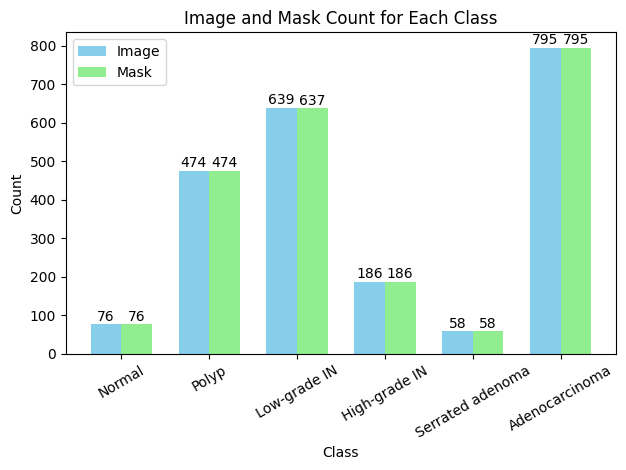

In [11]:
# Direktori Dataset
DATA_DIR = '/content/EBHI-SEG'

# Fungsi untuk menghitung jumlah file di setiap direktori
def count_files(directory):
    return len([filename for filename in os.listdir(directory) if os.path.isfile(os.path.join(directory, filename))])

# Dictionary untuk menyimpan jumlah gambar dan mask setiap kelas
data = {'Class': [], 'Image Count': [], 'Mask Count': []}

# Iterasi melalui setiap kelas
for class_name in classes:
    # Path ke direktori kelas
    class_dir = os.path.join(DATA_DIR, class_name)

    # Path ke direktori gambar dan label
    image_dir = os.path.join(class_dir, 'image')
    label_dir = os.path.join(class_dir, 'label')

    # Menghitung jumlah gambar dan mask
    image_count = count_files(image_dir)
    mask_count = count_files(label_dir)

    # Menambahkan data ke dictionary
    data['Class'].append(class_name)
    data['Image Count'].append(image_count)
    data['Mask Count'].append(mask_count)

# Membuat DataFrame dari dictionary
df = pd.DataFrame(data)

# Membuat grafik bar
fig, ax = plt.subplots()
bar_width = 0.35
opacity = 0.8

bar1 = ax.bar(df.index, df['Image Count'], bar_width, label='Image', color = 'skyblue')
bar2 = ax.bar(df.index + bar_width, df['Mask Count'], bar_width, label='Mask', color = 'lightgreen')

# Menambahkan label, judul, dan legend
ax.set_xlabel('Class')
ax.set_ylabel('Count')
ax.set_title('Image and Mask Count for Each Class')
ax.set_xticks(df.index + bar_width / 2)
ax.set_xticklabels(df['Class'], rotation = 30)
ax.legend()

# Menampilkan nilai di setiap bar
for i, v in enumerate(df['Image Count']):
    ax.text(i, v + 2, str(v), ha='center', va='bottom', color='black')

for i, v in enumerate(df['Mask Count']):
    ax.text(i + bar_width, v + 2, str(v), ha='center', va='bottom', color='black')

# Menampilkan grafik
plt.tight_layout()

plt.savefig('Number of Images and Masks per Class.png',
            dpi = 150, bbox_inches='tight', pad_inches=0.1)

# Menampilkan Grafik
plt.show()

In [12]:
# Set untuk menyimpan dimensi dan channel unik image dan mask
unique_image_info = set()
unique_mask_info = set()

# Set untuk menyimpan ekstensi file
unique_image_extensions = set()
unique_mask_extensions = set()

# Iterasi melalui setiap kelas
for class_name in classes:
    # Path ke direktori kelas
    class_dir = os.path.join(DATA_DIR, class_name)

    # Path ke direktori gambar dan label
    image_dir = os.path.join(class_dir, 'image')
    label_dir = os.path.join(class_dir, 'label')

    # Iterasi melalui setiap file gambar
    for image_filename in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_filename)

        # Mendapatkan dimensi dan channel gambar
        with Image.open(image_path) as img:
            image_info = (img.size, img.mode)
            unique_image_info.add(image_info)

        # Mendapatkan ekstensi gambar
        image_extension = os.path.splitext(image_filename)[1]
        unique_image_extensions.add(image_extension)

    # Iterasi melalui setiap file label
    for mask_filename in os.listdir(label_dir):
        mask_path = os.path.join(label_dir, mask_filename)

        # Mendapatkan dimensi dan channel mask
        with Image.open(mask_path) as mask:
            mask_info = (mask.size, mask.mode)
            unique_mask_info.add(mask_info)

        # Mendapatkan ekstensi mask
        mask_extension = os.path.splitext(mask_filename)[1]
        unique_mask_extensions.add(mask_extension)

# Menampilkan dimensi dan channel unik image dan mask
print("Unique Image Info:", unique_image_info)
print("Unique Mask Info:", unique_mask_info)

# Menampilkan ekstensi file unik
print("Unique Image Extensions:", unique_image_extensions)
print("Unique Mask Extensions:", unique_mask_extensions)

Unique Image Info: {((224, 224), 'RGB')}
Unique Mask Info: {((224, 224), 'L')}
Unique Image Extensions: {'.png'}
Unique Mask Extensions: {'.png'}


In [13]:
from collections import defaultdict

# Dictionary untuk menyimpan informasi file duplikat
duplicate_files = defaultdict(list)

# Iterasi melalui setiap kelas
for class_name in classes:
    # Path ke direktori kelas
    class_dir = os.path.join(DATA_DIR, class_name)

    # Path ke direktori gambar dan label
    image_dir = os.path.join(class_dir, 'image')
    label_dir = os.path.join(class_dir, 'label')

    # Mendapatkan daftar file gambar dan label
    image_files = os.listdir(image_dir)
    label_files = os.listdir(label_dir)

    # Mendeteksi file duplikat dalam gambar
    seen_image_files = set()
    for image_filename in image_files:
        if image_filename in seen_image_files:
            duplicate_files['Image'].append(os.path.join(class_name, 'Image', image_filename))
        else:
            seen_image_files.add(image_filename)

    # Mendeteksi file duplikat dalam label
    seen_label_files = set()
    for label_filename in label_files:
        if label_filename in seen_label_files:
            duplicate_files['Label'].append(os.path.join(class_name, 'Label', label_filename))
        else:
            seen_label_files.add(label_filename)

# Menampilkan informasi file duplikat
if not duplicate_files:
    print("Tidak ada file duplikat.")
else:
    print("File duplikat ditemukan:")
    for file_type, file_paths in duplicate_files.items():
        print(f"{file_type} Files:")
        for file_path in file_paths:
            print(f"  - {file_path}")

Tidak ada file duplikat.


### Show Image, Mask and Union for Selected Class

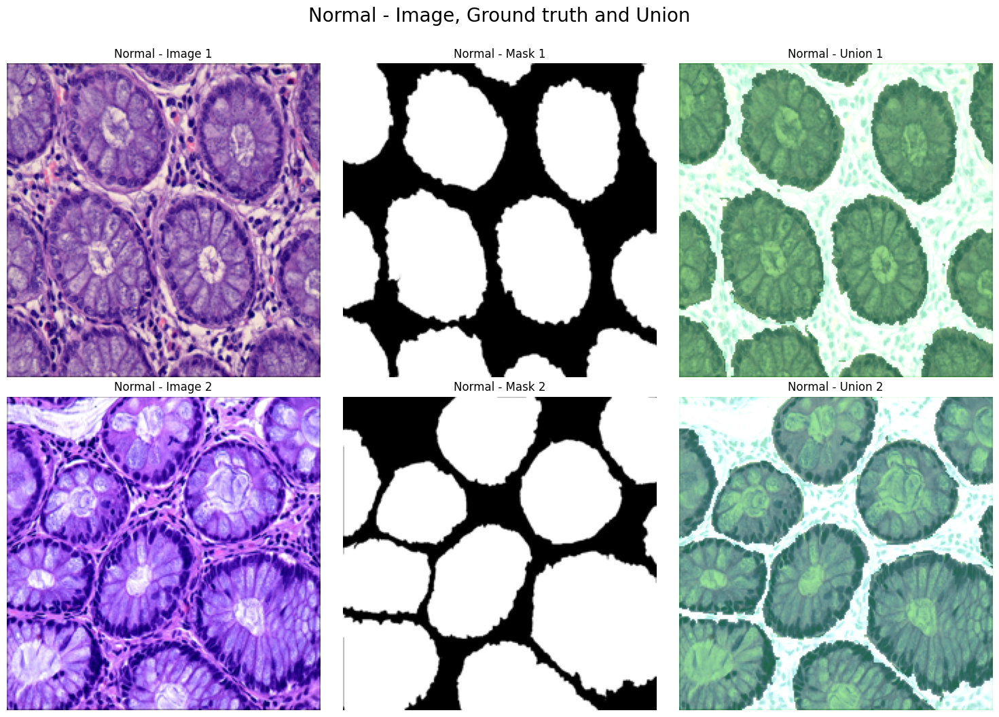

In [50]:
# Fungsi Load Image dan Mask (Label)
def load_image_and_mask(label, image_file):
    image_path = os.path.join(DATA_DIR, label, 'image', image_file)
    mask_path = os.path.join(DATA_DIR, label, 'label', image_file) #.replace('.png', '_mask.png'))

    image = cv2.imread(image_path)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

    return image, mask


# Fungsi membuat warna untuk masing-masing classes
def generate_colored_union(image, mask, label):
    color_index = classes[label]  # Get the index of the current label in the dictionary
    color = colors[color_index]

    # Print the mask values for debugging
    if mask is not None:  # Check if the mask is not empty
        # Create a color map for the binary mask
        mask_color = np.zeros_like(image)
        mask_color[mask == 0] = 255  # White color for object (0) in binary masks

        # Blend the original image and colored mask
        union = cv2.addWeighted(image, 0.5, mask_color, 0.5, 0)  # Equal alpha for image and mask

        # Convert the color from list to numpy.uint8
        color_bgr = np.array(color, dtype=np.uint8)

        union = cv2.addWeighted(union, 1, np.zeros_like(union) + color_bgr, 0.5, 0)

    else:
        # Handle the case where the mask is empty
        union = image

    return union

# Filter only the "Normal" class (or any other class you want)
selected_label = "Normal"
image_files = os.listdir(os.path.join(DATA_DIR, selected_label, 'image'))

# Create subplots with 2 rows and 3 columns
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))

for i, sample in enumerate(image_files[:2]):  # Displaying the first 2 images
    image, mask = load_image_and_mask(selected_label, sample)
    union = generate_colored_union(image, mask, selected_label)

    # Display image in the first column (column 0), mask in the second column (column 1), and union in the third column (column 2)
    axes[i, 0].set_title(f"{selected_label} - Image {i + 1}")
    axes[i, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[i, 0].axis('off')

    if mask is not None:
        axes[i, 1].set_title(f"{selected_label} - Mask {i + 1}")
        axes[i, 1].imshow(mask, cmap='gray')
        axes[i, 1].axis('off')

    axes[i, 2].set_title(f"{selected_label} - Union {i + 1}")
    axes[i, 2].imshow(cv2.cvtColor(union, cv2.COLOR_BGR2RGB))
    axes[i, 2].axis('off')

# Tweak the layout to prevent overlapping labels
plt.tight_layout()
plt.suptitle(f'{selected_label} - Image, Ground truth and Union', fontsize=20, y=1.05)

plt.savefig('Normal - Image Mask & Union.png',
            dpi = 150, bbox_inches='tight', pad_inches=0.1)

plt.show()

### Show Image, Mask and Union for Every Class

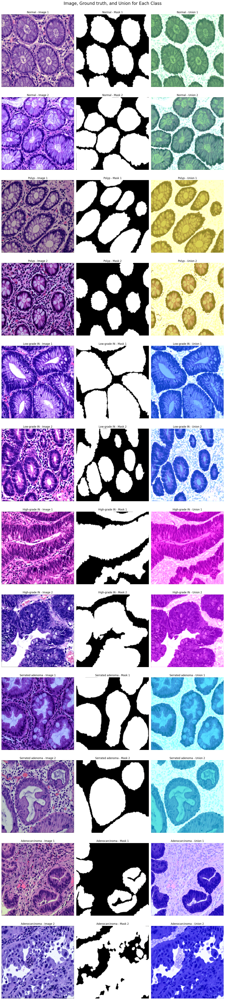

In [51]:
# Fungsi membuat warna untuk masing-masing classes
def generate_colored_union(image, mask, label, class_colors):
    class_index = classes[label]  # Get the class index based on the label
    color = class_colors[class_index]  # Get color based on class index

    # Print the mask values for debugging
    if mask is not None:  # Check if the mask is not empty
        # Create a color map for the binary mask
        mask_color = np.zeros_like(image)
        mask_color[mask == 0] = 255  # White color for object (0) in binary masks

        # Blend the original image and colored mask
        union = cv2.addWeighted(image, 0.5, mask_color, 0.5, 0)  # Equal alpha for image and mask

        # Convert the color from list to numpy.uint8
        color_bgr = np.array(color, dtype=np.uint8)

        union = cv2.addWeighted(union, 1, np.zeros_like(union) + color_bgr, 0.5, 0)  # Union color with transparency level

    else:
        # Handle the case where the mask is empty
        union = image

    return union


# Create subplots with 2 rows and 3 columns for each class
fig, axes = plt.subplots(nrows=2 * len(classes), ncols=3, figsize=(15, 11 * len(classes)))

for row, (selected_label, class_index) in enumerate(classes.items()):
    image_files = os.listdir(os.path.join(DATA_DIR, selected_label, 'image'))

    for i, sample in enumerate(image_files[:2]):  # Displaying the first 2 images for each class
        image, mask = load_image_and_mask(selected_label, sample)
        union = generate_colored_union(image, mask, selected_label, colors)

        # Calculate the index in the subplot grid
        subplot_index = 2 * row + i

        # Display image in the first column (column 0), mask in the second column (column 1), and union in the third column (column 2)
        axes[subplot_index, 0].set_title(f"{selected_label} - Image {i + 1}")
        axes[subplot_index, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[subplot_index, 0].axis('off')

        if mask is not None:
            axes[subplot_index, 1].set_title(f"{selected_label} - Mask {i + 1}")
            axes[subplot_index, 1].imshow(mask, cmap='gray')
            axes[subplot_index, 1].axis('off')

        axes[subplot_index, 2].set_title(f"{selected_label} - Union {i + 1}")
        axes[subplot_index, 2].imshow(cv2.cvtColor(union, cv2.COLOR_BGR2RGB))
        axes[subplot_index, 2].axis('off')

# Tweak the layout to prevent overlapping labels
plt.tight_layout()
plt.suptitle('Image, Ground truth, and Union for Each Class', fontsize=20, y=1.005)

plt.savefig('Image Mask & Union for Each Class.png',
            dpi = 150, bbox_inches='tight', pad_inches=0.1)

plt.show()

# Data Preparation System

In [16]:
trainDf = pd.read_csv('traindata.csv')
valDf = pd.read_csv('valdata.csv')
testDf = pd.read_csv('testdata.csv')

In [17]:
trainDf['Path'] = trainDf['Path'].str.strip()

In [18]:
trainDf

,Path
0,EBHI-SEG/Polyp/image/GTXC2110503-1-400-002.png
1,EBHI-SEG/Low-grade IN/image/GTDC2101366-1-400-...
2,EBHI-SEG/Adenocarcinoma/image/GTXC2012151-2-40...
3,EBHI-SEG/Polyp/image/GT2012191-1-400-002.png
4,EBHI-SEG/Adenocarcinoma/image/GTXC2015349-2-40...
...,...
1553,EBHI-SEG/Normal/image/GT2100144-1-400-004.png
1554,EBHI-SEG/Adenocarcinoma/image/GTXC2110135-2-40...
1555,EBHI-SEG/Adenocarcinoma/image/GT2001849-1-400-...
1556,EBHI-SEG/Adenocarcinoma/image/GTXC2015413-3-40...


In [19]:
dataDir = Path('EBHI-SEG')

classNames = [classes for classes in os.listdir(dataDir) if os.path.isdir(os.path.join(dataDir, classes))]
imageList = []
labelList = []
classList = []
splitClass = []
trainList = trainDf['Path'].tolist()
valList = valDf['Path'].tolist()
testList = testDf['Path'].tolist()

for className in classNames:
    classDir = os.path.join(dataDir, className)
    imageDir = os.path.join(classDir, 'image')
    labelDir = os.path.join(classDir, 'label')
    imagePath = [file for file in os.listdir(imageDir)]
    labelPath = [file for file in os.listdir(labelDir)]

    for img in imagePath:
        if img in labelPath:
            imageList.append(os.path.join(imageDir, img))
            labelList.append(os.path.join(labelDir, img))
            classList.append(className)
            if os.path.join(imageDir, img) in trainList:
                splitClass.append('train')
            elif os.path.join(imageDir, img) in valList:
                splitClass.append('validation')
            else:
                splitClass.append('testing')

In [20]:
df = pd.DataFrame({'image' : imageList, 'label' : labelList, 'class' : classList, 'split' : splitClass})

In [21]:
df['split'].unique()

array(['train', 'validation', 'testing'], dtype=object)

In [22]:
for folder in dataDir.iterdir():
    if folder.is_dir():
        for folder2 in folder.iterdir():
            if folder2.is_dir():
                print(folder.name)
                print(folder2.name)
                print(len(os.listdir(folder2)))

Low-grade IN
label
637
Low-grade IN
image
639
Polyp
label
474
Polyp
image
474
Serrated adenoma
label
58
Serrated adenoma
image
58
High-grade IN
label
186
High-grade IN
image
186
Normal
label
76
Normal
image
76
Adenocarcinoma
label
795
Adenocarcinoma
image
795


In [23]:
df.to_csv('imageLabel.csv', index=False)

# Data preparation

In [24]:
df = pd.read_csv('imageLabel.csv')
df

,image,label,class,split
0,EBHI-SEG/Low-grade IN/image/GT2012246-1-400-00...,EBHI-SEG/Low-grade IN/label/GT2012246-1-400-00...,Low-grade IN,train
1,EBHI-SEG/Low-grade IN/image/GTxc2012803-1-400-...,EBHI-SEG/Low-grade IN/label/GTxc2012803-1-400-...,Low-grade IN,train
2,EBHI-SEG/Low-grade IN/image/GT2012212-1-400-00...,EBHI-SEG/Low-grade IN/label/GT2012212-1-400-00...,Low-grade IN,train
3,EBHI-SEG/Low-grade IN/image/GTxc2013400-1-400-...,EBHI-SEG/Low-grade IN/label/GTxc2013400-1-400-...,Low-grade IN,validation
4,EBHI-SEG/Low-grade IN/image/GTxc2012896-1-400-...,EBHI-SEG/Low-grade IN/label/GTxc2012896-1-400-...,Low-grade IN,train
...,...,...,...,...
2221,EBHI-SEG/Adenocarcinoma/image/GTxc2013512-1-40...,EBHI-SEG/Adenocarcinoma/label/GTxc2013512-1-40...,Adenocarcinoma,validation
2222,EBHI-SEG/Adenocarcinoma/image/GTxc2012990-1-40...,EBHI-SEG/Adenocarcinoma/label/GTxc2012990-1-40...,Adenocarcinoma,train
2223,EBHI-SEG/Adenocarcinoma/image/GT2014665-3-400-...,EBHI-SEG/Adenocarcinoma/label/GT2014665-3-400-...,Adenocarcinoma,train
2224,EBHI-SEG/Adenocarcinoma/image/GT2016906-2-400-...,EBHI-SEG/Adenocarcinoma/label/GT2016906-2-400-...,Adenocarcinoma,train


In [25]:
df[df['split'] == 'train']

,image,label,class,split
0,EBHI-SEG/Low-grade IN/image/GT2012246-1-400-00...,EBHI-SEG/Low-grade IN/label/GT2012246-1-400-00...,Low-grade IN,train
1,EBHI-SEG/Low-grade IN/image/GTxc2012803-1-400-...,EBHI-SEG/Low-grade IN/label/GTxc2012803-1-400-...,Low-grade IN,train
2,EBHI-SEG/Low-grade IN/image/GT2012212-1-400-00...,EBHI-SEG/Low-grade IN/label/GT2012212-1-400-00...,Low-grade IN,train
4,EBHI-SEG/Low-grade IN/image/GTxc2012896-1-400-...,EBHI-SEG/Low-grade IN/label/GTxc2012896-1-400-...,Low-grade IN,train
6,EBHI-SEG/Low-grade IN/image/GT2100144-1-400-00...,EBHI-SEG/Low-grade IN/label/GT2100144-1-400-00...,Low-grade IN,train
...,...,...,...,...
2218,EBHI-SEG/Adenocarcinoma/image/GTXC2012151-2-40...,EBHI-SEG/Adenocarcinoma/label/GTXC2012151-2-40...,Adenocarcinoma,train
2222,EBHI-SEG/Adenocarcinoma/image/GTxc2012990-1-40...,EBHI-SEG/Adenocarcinoma/label/GTxc2012990-1-40...,Adenocarcinoma,train
2223,EBHI-SEG/Adenocarcinoma/image/GT2014665-3-400-...,EBHI-SEG/Adenocarcinoma/label/GT2014665-3-400-...,Adenocarcinoma,train
2224,EBHI-SEG/Adenocarcinoma/image/GT2016906-2-400-...,EBHI-SEG/Adenocarcinoma/label/GT2016906-2-400-...,Adenocarcinoma,train


In [26]:
df[df['split'] == 'validation']

,image,label,class,split
3,EBHI-SEG/Low-grade IN/image/GTxc2013400-1-400-...,EBHI-SEG/Low-grade IN/label/GTxc2013400-1-400-...,Low-grade IN,validation
5,EBHI-SEG/Low-grade IN/image/GT2012400-1-400-00...,EBHI-SEG/Low-grade IN/label/GT2012400-1-400-00...,Low-grade IN,validation
7,EBHI-SEG/Low-grade IN/image/GT2012149-2-400-00...,EBHI-SEG/Low-grade IN/label/GT2012149-2-400-00...,Low-grade IN,validation
10,EBHI-SEG/Low-grade IN/image/GTXC2015362-5-400-...,EBHI-SEG/Low-grade IN/label/GTXC2015362-5-400-...,Low-grade IN,validation
13,EBHI-SEG/Low-grade IN/image/GTxc2012827-1-400-...,EBHI-SEG/Low-grade IN/label/GTxc2012827-1-400-...,Low-grade IN,validation
...,...,...,...,...
2196,EBHI-SEG/Adenocarcinoma/image/GTxc2012996-1-40...,EBHI-SEG/Adenocarcinoma/label/GTxc2012996-1-40...,Adenocarcinoma,validation
2210,EBHI-SEG/Adenocarcinoma/image/GT2016841-1-400-...,EBHI-SEG/Adenocarcinoma/label/GT2016841-1-400-...,Adenocarcinoma,validation
2219,EBHI-SEG/Adenocarcinoma/image/GTXC2015362-9-40...,EBHI-SEG/Adenocarcinoma/label/GTXC2015362-9-40...,Adenocarcinoma,validation
2220,EBHI-SEG/Adenocarcinoma/image/GT2012508-3-400-...,EBHI-SEG/Adenocarcinoma/label/GT2012508-3-400-...,Adenocarcinoma,validation


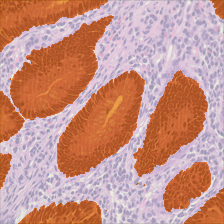

In [30]:
randidx = np.random.randint(0, len(df))
# Show one sample image
colorMap = np.array(colors, dtype=np.uint8)
img = Image.open(df.iloc[randidx,0])
lbl = np.array(Image.open(df.iloc[randidx,1]))
lblBin = (lbl > 0).astype(np.uint8) * classes[df.iloc[randidx,2]]
coloredBin = Image.fromarray(colorMap[lblBin]).convert('RGB')
overlay = Image.blend(img, coloredBin, alpha=.6)
overlay

In [31]:
df['class'].unique()

array(['Low-grade IN', 'Polyp', 'Serrated adenoma', 'High-grade IN',
       'Normal', 'Adenocarcinoma'], dtype=object)

In [32]:
class customDataset(Dataset):
    def __init__(self, imageList, labelList, classList, classDict, transforms=None):
        assert len(imageList) == len(labelList) and len(imageList) == len(classList) and len(labelList) == len(classList), '3 of the list are not the same length'
        self.imageList = imageList
        self.labelList = labelList
        self.classList = classList
        self.classDict = classDict
        self.transforms = transforms
    def __len__(self):
        return len(self.imageList)
    def __getitem__(self, index):
        image = np.array(Image.open(self.imageList[index]))
        mask = np.array(Image.open(self.labelList[index]))
        mask = (mask > 0).astype(np.uint8) * self.classDict[self.classList[index]]
        if self.transforms:
            transformed = self.transforms(image=image, mask=mask)
            imgAug = transformed['image'].contiguous()
            maskAug = transformed['mask'].contiguous()
            return imgAug, maskAug
        image = torch.as_tensor(image).float().contiguous()
        mask = torch.as_tensor(mask).long().contiguous()
        return image, mask

class dataModule(pl.LightningDataModule):
    def __init__(self, df, classDict, batchSize):
        super().__init__()
        self.df = df
        self.batchSize = batchSize
        self.classDict = classDict
    def prepare_data(self):
        #No data download, so we pass this
        pass
    def _getTransform(self,train=True):
        if train:
            return A.Compose([
                A.OneOf([
                    A.VerticalFlip(),
                    A.HorizontalFlip(),
                    A.RandomRotate90(),
                ], p=.5),
                ToTensorV2()
            ])
        return A.Compose([
            ToTensorV2()
        ])
    def setup(self, stage: str):
        trainTransform = self._getTransform()
        valTransform = self._getTransform(False)
        self.trainingSet = customDataset(df[df['split'] == 'train']['image'].tolist(), df[df['split'] == 'train']['label'].tolist(), df[df['split'] == 'train']['class'].tolist(), classDict=self.classDict, transforms=trainTransform)
        self.valSet = customDataset(df[df['split'] == 'validation']['image'].tolist(), df[df['split'] == 'validation']['label'].tolist(), df[df['split'] == 'validation']['class'].tolist(), classDict=self.classDict, transforms=valTransform)
        self.testSet = customDataset(df[df['split'] == 'testing']['image'].tolist(), df[df['split'] == 'testing']['label'].tolist(), df[df['split'] == 'testing']['class'].tolist(), classDict=self.classDict, transforms=valTransform)
    def train_dataloader(self):
        return DataLoader(self.trainingSet, batch_size=self.batchSize, num_workers=4, drop_last=True, pin_memory=True, shuffle=True)
    def val_dataloader(self):
        return DataLoader(self.valSet, batch_size=self.batchSize, num_workers=4, drop_last=True, pin_memory=True, shuffle=False)
    def predict_dataloader(self):
        return DataLoader(self.testSet, batch_size=self.batchSize, num_workers=4, drop_last=True, pin_memory=True, shuffle=False)

In [33]:
import torch
from torch import Tensor

# Define function to calculate DICE Coefficient between two tensors of input and target

def dice_coeff(input: Tensor, target: Tensor, reduce_batch_first: bool = False, epsilon: float = 1e-6):
    # Make sure the same size between input and target
    assert input.size() == target.size()
    # Make sure input is 3D tensor or do not reduce batch dimension if not allowed
    assert input.dim() == 3 or not reduce_batch_first

    # Calculate dimension for the DICE
    sum_dim = (-1, -2) if input.dim() == 2 or not reduce_batch_first else (-1, -2, -3)

    # Calculate intersection
    inter = 2 * (input * target).sum(dim=sum_dim)

    # Calculate positive element in input and target
    sets_sum = input.sum(dim=sum_dim) + target.sum(dim=sum_dim)

    # Avoid division by zero with changing zero in sets_num by inter
    sets_sum = torch.where(sets_sum == 0, inter, sets_sum)

    # Calculate DICE coefficient by adding epsilon to avoid division by zero
    dice = (inter + epsilon) / (sets_sum + epsilon)

    # Return mean DICE coefficcient
    return dice.mean()

# Define function to calculate DICE coefficient in multiclass between two tensors of input and target

def multiclass_dice_coef(input: Tensor, target: Tensor, reduce_batch_first: bool = False, epsilon: float = 1e-6):
    # Use DICE coefficient after flatten input and target tensors
    return dice_coeff(input.flatten(0, 1), target.flatten(0, 1), reduce_batch_first, epsilon)


# Define function to calculate DICE loss in multiclass

def dice_loss(input: Tensor, target: Tensor, multiclass: bool = False):
    # Choose the function based on multiclass activation
    fn = multiclass_dice_coef if multiclass else dice_coeff
    # DICE loss is 1-DICE coefficient
    return 1 - fn(input, target, reduce_batch_first=True)

# AttUNet

In [34]:
import torch
import torch.nn as nn
import torch.nn.functional as F

import math

class SpatialAttention(nn.Module):
    def __init__(self):
        super(SpatialAttention, self).__init__()
        self.conv = nn.Conv2d(2, 1, kernel_size=3, padding=1)

    def forward(self, x):
        avg = torch.mean(x, dim=1, keepdim=True)
        max_val, _ = torch.max(x, dim=1, keepdim=True)
        x = torch.cat((avg, max_val), dim=1)  # Concatenate along the channel dimension
        x = self.conv(x)
        return torch.sigmoid(x)

class ChannelAttention(nn.Module):
    def __init__(self, in_channels):
        super(ChannelAttention, self).__init__()
        self.in_channel = in_channels
        self.convblock = nn.Sequential(
            nn.Conv2d(in_channels, math.ceil(in_channels // 16), 1),
            nn.Conv2d(math.ceil(in_channels // 16), math.ceil(in_channels // 16), 3, padding=1),
            nn.Conv2d(math.ceil(in_channels // 16), in_channels, 1)
        )

    def forward(self, x):
        avg = torch.mean(x, dim=(-2,-1), keepdim=True)
        max_val, _ = torch.max(x.view(x.size(0), x.size(1), -1), dim=2, keepdim=True)
        max_val = max_val.view(x.size(0), x.size(1), 1, 1)
        outAvg = self.convblock(avg)
        outMax = self.convblock(max_val)
        x = torch.add(outAvg, outMax)
        return torch.sigmoid(x)

class AttentionConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, residual=False):
        super(AttentionConvBlock, self).__init__()
        self.residual = residual
        self.resconv = nn.Conv2d(in_channels, out_channels, 1, 1)
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.spatialAtt = SpatialAttention()
        self.channelAtt = ChannelAttention(out_channels)

    def forward(self, x):
        if self.residual:
            residual = self.resconv(x)
        x = self.double_conv(x)
        cam = self.channelAtt(x)
        sam = self.spatialAtt(x)
        camx = torch.mul(x, cam)
        samx = torch.mul(x, sam)
        if self.residual:
            return  camx + samx + residual
        return camx + samx

class AttDown(nn.Module):
    def __init__(self, in_channels, out_channels, residual=False, *args, **kwargs) -> None:
        super().__init__(*args, **kwargs)
        self.maxpool_conv = nn.Sequential(
            # Max-pooling for downsampling
            nn.MaxPool2d(2),
            # Two layers conv
            AttentionConvBlock(in_channels, out_channels, residual=residual)
        )

    def forward(self, x):
        return self.maxpool_conv(x)


class AttUp(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True, residual=False,*args, **kwargs) -> None:
        super().__init__(*args, **kwargs)
        if bilinear:
            # Upsampling by bilinear interpolation
            self.up = nn.Upsample(
                scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = AttentionConvBlock(in_channels, out_channels // 2, residual=residual)
        else:
            # Upsampling by transpose conv
            self.up = nn.ConvTranspose2d(
                in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = AttentionConvBlock(in_channels, out_channels, residual=residual)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        # Padding to change size x1 = x2
        x1 = F.pad(x1, [diffX // 2, diffX - diffX //
                   2, diffY // 2, diffY - diffY // 2])

        # Concatenate x1 and x2, then two layers conv
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels, *args, **kwargs) -> None:
        super().__init__(*args, **kwargs)
        # Conv layer 1x1 for the output
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

# Example usage:
if __name__ == "__main__":
    input_tensor = torch.randn(1, 3, 128, 128)  # 1 batch, 3 channels, 128x128 image
    model = AttentionConvBlock(3, 64, residual=True)
    output = model(input_tensor)
    print(output.shape)  # Should be (1, 64, 128, 128)
    down = AttDown(64, 128, residual=True)
    output2 = down(output)
    print(output2.shape)
    up = AttUp(128, 64, bilinear=False,residual=True)
    print(up(output2, output).size())

torch.Size([1, 64, 128, 128])
torch.Size([1, 128, 64, 64])
torch.Size([1, 64, 128, 128])


In [35]:
from torchinfo import summary

class AttUNetModel(nn.Module):
    def __init__(self, n_channels, n_classes, init_filter=64, bilinear=False, residual=False,*args, **kwargs) -> None:
        super().__init__(*args, **kwargs)
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        # AttUNet composition
        self.inputTensor = (AttentionConvBlock(n_channels, init_filter, residual=residual))
        self.down1 = (AttDown(init_filter, init_filter*2, residual=residual))
        self.down2 = (AttDown(init_filter*2, init_filter*4, residual=residual))
        self.down3 = (AttDown(init_filter*4, init_filter*8, residual=residual))
        factor = 2 if bilinear else 1
        self.down4 = (AttDown(init_filter*8, init_filter*16 // factor, residual=residual))
        self.up1 = (AttUp(init_filter*16, init_filter*8 // factor, bilinear, residual=residual))
        self.up2 = (AttUp(init_filter*8, init_filter*4 // factor, bilinear, residual=residual))
        self.up3 = (AttUp(init_filter*4, init_filter*2 // factor, bilinear, residual=residual))
        self.up4 = (AttUp(init_filter*2, init_filter, bilinear, residual=residual))
        self.outputTensor = (OutConv(init_filter, n_classes))

    def forward(self, x):
        x1 = self.inputTensor(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outputTensor(x)
        return logits

    def use_checkpointing(self):
        # Checkpoints in some layers
        self.inputTensor = torch.utils.checkpoint(self.inputTensor)
        self.down1 = torch.utils.checkpoint(self.down1)
        self.down2 = torch.utils.checkpoint(self.down2)
        self.down3 = torch.utils.checkpoint(self.down3)
        self.down4 = torch.utils.checkpoint(self.down4)
        self.up1 = torch.utils.checkpoint(self.up1)
        self.up2 = torch.utils.checkpoint(self.up2)
        self.up3 = torch.utils.checkpoint(self.up3)
        self.up4 = torch.utils.checkpoint(self.up4)
        self.outputTensor = torch.utils.checkpoint(self.outputTensor)

if __name__ == "__main__":
    # Instantiate the model and display the summary
    model = AttUNetModel(n_channels=3, n_classes=7, init_filter=64)
    summary(model, input_size=(1,3,400,400))
    resmodel = AttUNetModel(n_channels=3, n_classes=7, init_filter=64, residual=True)
    summary(resmodel, input_size=(1,3,400,400))

In [36]:
model = AttUNetModel(n_channels=3, n_classes=5)
summary(model, input_size=(1,3,224,224))

Layer (type:depth-idx)                        Output Shape              Param #
AttUNetModel                                  [1, 5, 224, 224]          --
├─AttentionConvBlock: 1-1                     [1, 64, 224, 224]         256
│    └─Sequential: 2-1                        [1, 64, 224, 224]         --
│    │    └─Conv2d: 3-1                       [1, 64, 224, 224]         1,792
│    │    └─BatchNorm2d: 3-2                  [1, 64, 224, 224]         128
│    │    └─ReLU: 3-3                         [1, 64, 224, 224]         --
│    │    └─Conv2d: 3-4                       [1, 64, 224, 224]         36,928
│    │    └─BatchNorm2d: 3-5                  [1, 64, 224, 224]         128
│    │    └─ReLU: 3-6                         [1, 64, 224, 224]         --
│    └─ChannelAttention: 2-2                  [1, 64, 1, 1]             --
│    │    └─Sequential: 3-7                   [1, 64, 1, 1]             728
│    │    └─Sequential: 3-8                   [1, 64, 1, 1]             (recursive)


In [37]:
class AttUNetModule(pl.LightningModule):
    def __init__(self, nClasses = 7, lr= 0.01, decay=0):
        super().__init__()
        self.model = AttUNetModel(n_channels=3, n_classes=nClasses)
        self.nClasses = nClasses
        self.lr = lr
        self.decay = decay
        self.save_hyperparameters()
        self.criterion = nn.CrossEntropyLoss()
    def forward(self, x):
        logits = self.model(x)
        return logits
    def training_step(self, batch, batch_idx):
        img, mask = batch
        img = img.to(device=self.device, dtype=torch.float32, memory_format=torch.channels_last)
        mask = mask.to(device=self.device, dtype=torch.long)
        predMask = self.forward(img)
        loss = self.criterion(predMask, mask)
        loss += dice_loss(f.softmax(predMask, dim=1).float(), f.one_hot(mask, self.nClasses).permute(0, 3, 1, 2).float(), multiclass=True)
        self.log('diceLoss', loss, on_step=False, on_epoch=True, prog_bar=True)
        return loss
    def validation_step(self, batch, batch_idx):
        img, mask = batch
        totalN = self.trainer.num_val_batches[0]
        img = img.to(device=self.device, dtype=torch.float32, memory_format=torch.channels_last)
        mask = mask.to(device=self.device, dtype=torch.long)
        assert mask.min() >= 0 and mask.max() < self.nClasses, f'True mask indices should be in [0, {self.nClasses}]'
        predMask = self.forward(img)
        mask = f.one_hot(mask, self.nClasses).permute(0, 3, 1, 2).float()
        predMask = f.one_hot(predMask.argmax(dim=1), self.nClasses).permute(0, 3, 1, 2).float()
        diceScore = multiclass_dice_coef(predMask[:,1:], mask[:, 1:], reduce_batch_first=False)
        self.log('diceScore', diceScore, on_step=False, on_epoch=True, prog_bar=True, reduce_fx=torch.mean)
        return diceScore
    def predict_step(self, batch, batch_idx):
        img, mask = batch
        img = img.to(device =self.device, dtype=torch.float32)
        outputs = self.forward(img)
        predMask = outputs.argmax(dim=1)

        mask = f.one_hot(mask.long(), self.nClasses).permute(0, 3, 1, 2).float()
        predictionMask = f.one_hot(predMask.cpu(), self.nClasses).permute(0, 3, 1, 2).float()

        return img, predMask.long().squeeze().cpu().numpy(), mask, predictionMask
    def configure_optimizers(self):
        optimizer = optim.Adam(self.parameters(), lr=self.lr, weight_decay=self.decay)
        scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=5, mode='min')
        return {
            'optimizer' : optimizer,
            'lr_scheduler' : {
                'scheduler' : scheduler,
                'monitor' : 'diceLoss'
            }
        }
        # return optimizer

# Train the Model

In [38]:
# Mengukur waktu pelatihan model
import time
start_time = time.time()


dataMod = dataModule(df=df, classDict=classes, batchSize=6)
model = AttUNetModule(lr=0.00001)
lrMonitor = LearningRateMonitor(logging_interval='epoch')
logger = TensorBoardLogger('tb_logs', name='AttUNetSegm')
trainer = pl.Trainer(accelerator='gpu', devices=[0], max_epochs=100, logger=logger, callbacks=[lrMonitor])
trainer.fit(model=model, datamodule=dataMod)


# Menghitung waktu pelatihan
training_time = time.time() - start_time
print("Total training time: {:.2f} seconds".format(training_time))
print("Total training time: {:.2f} hours".format(training_time/3600))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type             | Params
-----------------------------------------------
0 | model     | AttUNetModel     | 32.7 M
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
32.7 M    Trainable params
0         Non-trainable params
32.7 M    Total params
130.891   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.


Total training time: 11519.43 seconds
Total training time: 3.20 hours


# Results

In [42]:
# Predict only
dataMod1 = dataModule(df=df, classDict=classes, batchSize=6)
model1 = AttUNetModule(lr=0.001)
lrMonitor1 = LearningRateMonitor(logging_interval='epoch')
# logger1 = TensorBoardLogger('tb_logs', name='AttUNetSegm')
trainer1 = pl.Trainer(accelerator='gpu', devices=[0], max_epochs=100, callbacks=[lrMonitor1])
results = trainer1.predict(model=model1, datamodule=dataMod1, ckpt_path='/content/tb_logs/AttUNetSegm/version_0/checkpoints/epoch=99-step=25900.ckpt')

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at /content/tb_logs/AttUNetSegm/version_0/checkpoints/epoch=99-step=25900.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from the checkpoint at /content/tb_logs/AttUNetSegm/version_0/checkpoints/epoch=99-step=25900.ckpt


Predicting: |          | 0/? [00:00<?, ?it/s]

In [44]:
results = trainer.predict(model=model, datamodule=dataMod)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

In [45]:
numClasses = [0,1,2,3,4,5,6]

In [46]:
def mask_to_image(preds, mask_values, colors=colors):
    listOverlay = []

    originalMask = [batch[2] for batch in preds]
    originalMask = torch.stack([orMask for batch in originalMask for orMask in batch])
    predictionMask = [batch[3] for batch in preds]
    predictionMask = torch.stack([preMask for batch in predictionMask for preMask in batch])
    images = [batch[0] for batch in preds]
    images = torch.stack([img for batch in images for img in batch])
    masks = [batch[1] for batch in preds]
    masks = np.array([mask for batch in masks for mask in batch])
    recalls = multilabel_recall(predictionMask, originalMask, num_labels=len(mask_values), average='none')
    precisions = multilabel_precision(predictionMask, originalMask, num_labels=len(mask_values), average='none')
    print(f'recalls = background : {recalls[0]:.2f}, normal : {recalls[1]:.2f}, polyp : {recalls[2]:.2f}, serrated adenoma : {recalls[3]:.2f}, low-grade IN : {recalls[4]:.2f}, high-grade IN : {recalls[5]:.2f}, adenocarcinoma : {recalls[6]:.2f}')
    print(f'precisions = background : {precisions[0]:.2f}, normal : {precisions[1]:.2f}, polyp : {precisions[2]:.2f}, serrated adenoma : {precisions[3]:.2f}, low-grade IN : {precisions[4]:.2f}, high-grade IN : {precisions[5]:.2f}, adenocarcinoma : {precisions[6]:.2f}')
    for img, mask in zip(images, masks):
        if isinstance(mask_values[0], list):
            out = np.zeros((mask.shape[-2], mask.shape[-1], len(mask_values[0])), dtype=np.uint8)
        elif mask_values == [0, 1]:
            out = np.zeros((mask.shape[-2], mask.shape[-1]), dtype=bool)
        else:
            out = np.zeros((mask.shape[-2], mask.shape[-1]), dtype=np.uint8)

        if mask.ndim == 3:
            mask = np.argmax(mask, axis=0)

        for i, v in enumerate(mask_values):
            out[mask == i] = v

        classColorMap = np.array(colors, dtype=np.uint8)
        realImg = Image.fromarray(img.cpu().permute(1,2,0).numpy().astype(np.uint8))
        annIm = Image.fromarray(classColorMap[out])
        annImage = annIm.convert('RGB')
        overlay = Image.blend(realImg, annImage, alpha=.7)
        listOverlay.append(overlay)
    return listOverlay

In [47]:
overlay = mask_to_image(results, numClasses, colors=colors)

recalls = background : 0.89, normal : 0.46, polyp : 0.88, serrated adenoma : 0.62, low-grade IN : 0.90, high-grade IN : 0.79, adenocarcinoma : 0.92
precisions = background : 0.92, normal : 0.75, polyp : 0.85, serrated adenoma : 0.70, low-grade IN : 0.92, high-grade IN : 0.67, adenocarcinoma : 0.86


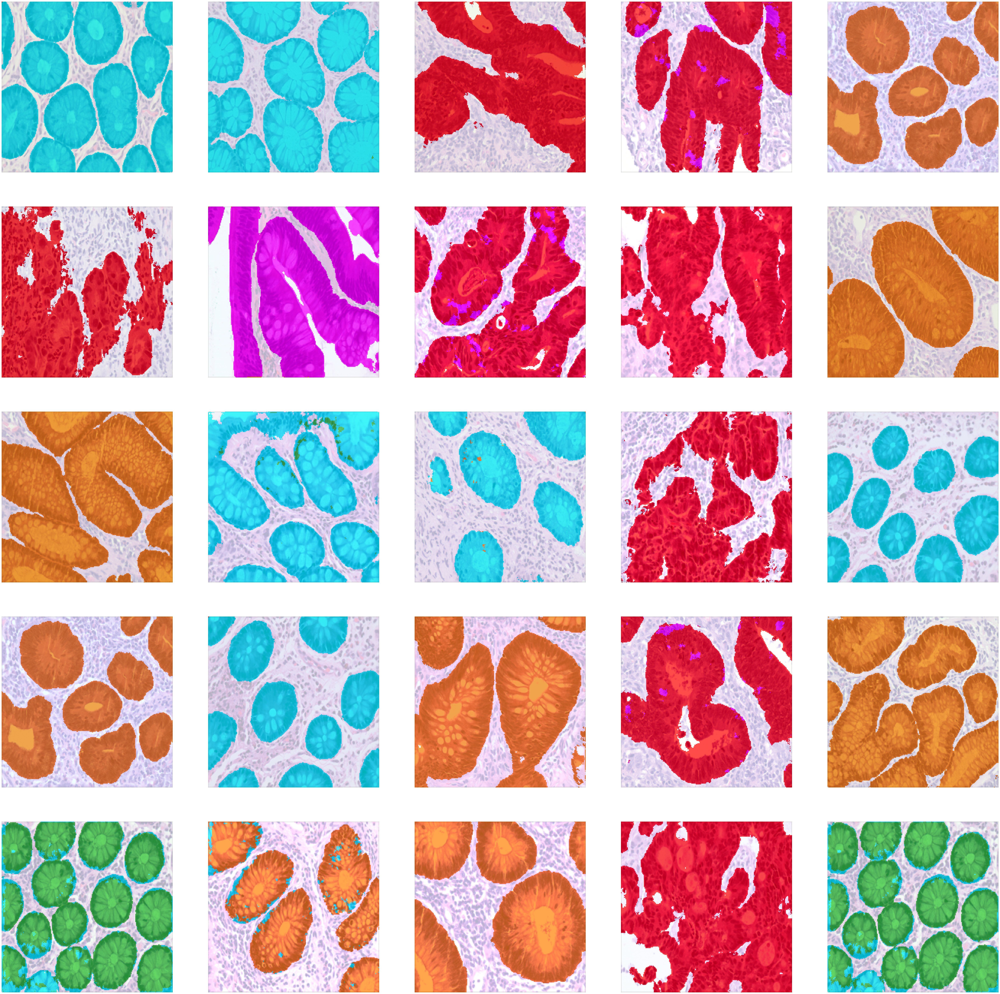

In [48]:
fig, axes = plt.subplots(5, 5, figsize=(80,80))
indices = np.arange(0, len(overlay), step=1)
for i, ax in enumerate(axes.flatten()):
    ax.imshow(overlay[random.choices(indices)[0]])
    ax.axis('off')

plt.show()